In [1]:
# import necessary libraries
import pandas as pd  # data wranglin'
import sys  # append paths
import os  # mess with the operating system
# %pip install sodapy
from sodapy import Socrata  #pull data with Tyler api
import plotly.express as px
import json
import numpy as np
# %pip install statsmodels
import statsmodels.api as sm
import requests

In [2]:
#config, load storage data

sys.path.append('/workspaces/')

'''
beats.geojson is provided by the city of Chicago, denoting police beats
the policy of interest was implemented at the police-beat level
beats are smaller than neighborhoods, and in some cases cross multiple neighborhoods
'''

#geospatial boundaries of neighborhoods in chicago
with open('/workspaces/acs-study/data/beats.geojson', 'r') as beats_json:
    beats_data = json.load(beats_json)
    
client = Socrata('data.cityofchicago.org',
                 os.environ['CHICAGO_DATA_APP_TOKEN'],  #secrets stay secret, sorry not sorry
                 username="bk2988a@american.edu",
                 password=os.environ['CHICAGO_DATA_PWD'])  #pwds are not for sharing
client.timeout = 30

# get data from API

# results = client.get("ijzp-q8t2", limit=2000000)  # use Socrata client to pull Chicago's crime data from 2001 to today
# I loaded this data into local storage because this pull takes a very long time
# if you use the same dataset, you should be able to replicate my results

In [3]:
health_portal_url = 'https://chicagohealthatlas.org/api/v1/data/'
health_data = requests.get(
    health_portal_url,
    params = {
        # homicides, firearm, alcohol, drugs, overdoses, suicides, behav hosp, depress hosp, hischool suicide attmpt, psych distress, HCSAPDP
        # VRHOR,VRFIR,VRALR,VRDIDR,VRDOR,VRSUR,HDBHR,YRSUP,HDMDR
        # 'topic':'VRHOR',
        # 'population':'',
        'geography':'southwest',
        'layer':'zip'
    }
)

In [9]:
# cleaning up data, casting to correct dtypes

crime_df = pd.read_csv(
    '/workspaces/acs-study/data/data.csv',
    dtype={
        'beat':object  #beats are strings, not ints despite looking like ints
    }
)
crime_df['latitude'] = pd.to_numeric(crime_df['latitude'])
crime_df['longitude'] = pd.to_numeric(crime_df['longitude'])
crime_df['community_area'] = pd.to_numeric(crime_df['community_area'])
crime_df['date'] = pd.to_datetime(crime_df['date'])

# coding violent crimes
violent = ['BATTERY', 'ASSAULT', 'ROBBERY', 'CRIMINAL SEXUAL ASSAULT', 'HOMICIDE', 'CRIM SEXUAL ASSAULT', 'KIDNAPPING', 'ARSON']
crime_df['violent'] = crime_df['primary_type'].isin(violent)

In [11]:
# make a dataframe of beats with their coordinates

beats = []  #geometry of all community areas
properties = [
    'beat',
    'beat_num',
    'district',
    'sector'
]  # these are all available properties of a beat in the geojson

#iterates over geojson. this maps beat ID to the geographic object
for feature in beats_data['features']:  # each 'feature' is beat : {properties, geometry : {coordinates}}
    beat = []
    for property in properties:
        beat.append(feature['properties'][property])
        
    beat.append(feature['geometry']['coordinates'])  # capture actual geometry
    beats.append(beat)  # add the beat to the geodataset

# beats_df maps geometry to beat number
beats_df = pd.DataFrame(beats)
beats_df.columns = ['beat', 'beat_num', 'district', 'sector', 'geometry']

In [47]:
# districts with non-police response
non_police_districts = ['08', '07', '01']

# districts with co-responder model
co_responder_districts = ['06', '19']

# code all crimes as occurring in either non-police, co-responder, or control
def treatment(district):
    if district in non_police_districts:
        return 'Non-police'
    elif district in co_responder_districts:
        return 'Co-responder'
    else:
        return 'Control'
    
beats_df['Treatment'] = beats_df['district'].apply(treatment)  #which treatment the neighborhood received

spatial_crimes_df = crime_df.merge(beats_df, how='left', left_on='beat', right_on='beat_num')  #add neighborhood names
spatial_crimes_df = spatial_crimes_df.set_index('date')
spatial_crimes_df = spatial_crimes_df.sort_index().loc['2019-01-01':'2023-12-31']  #only look at the last 5 years


In [13]:
# map makin time
import plotly.express as px
import plotly.graph_objs as go
import plotly.io as pio
pio.renderers.default = "plotly_mimetype+notebook"

figure = px.choropleth(
    beats_df,
    geojson=beats_data,
    locations='beat_num',
    color='Treatment',
    center = {
        'lat': 41.8781,
        'lon': -87.6298
    },
    featureidkey='properties.beat_num',
    color_discrete_sequence=['#D1CFE2', '#50858B', '#C2A83E'],
    projection='orthographic'  # mercator is kinda racist tho
)

figure.update_geos(fitbounds="locations", visible=False)
figure.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

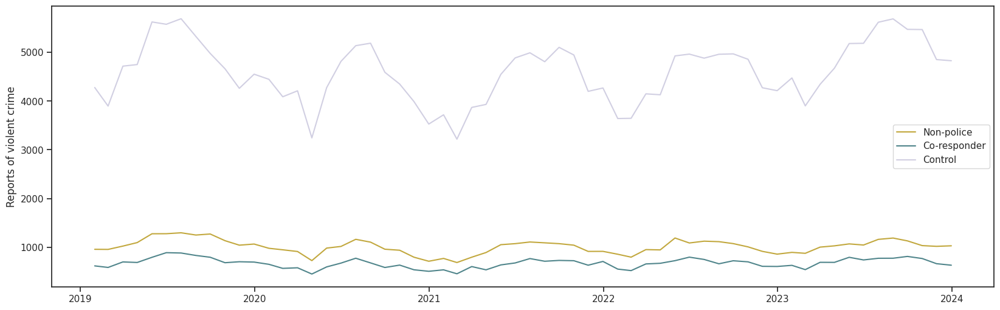

In [49]:
import seaborn as sns
import matplotlib.pyplot as plt
violent_df = spatial_crimes_df[spatial_crimes_df['violent'] == True]
v_np = violent_df[violent_df['Treatment'] == 'Non-police']
v_cr = violent_df[violent_df['Treatment'] == 'Co-responder']
v_ct = violent_df[violent_df['Treatment'] == 'Control']
# Set the figure size
plt.figure(figsize=(20, 6))
sns.set_theme(context='notebook', style='ticks', palette=['#C2A83E', '#50858B', '#D1CFE2'])

# Sample the data monthly
v_np = v_np.sort_index().resample('ME').size().reset_index()
v_cr = v_cr.sort_index().resample('ME').size().reset_index()
v_ct = v_ct.sort_index().resample('ME').size().reset_index()

# Plot the data
sns.lineplot(x='date', y=0, data=v_np, label='Non-police')
sns.lineplot(x='date', y=0, data=v_cr, label='Co-responder')
sns.lineplot(x='date', y=0, data=v_ct, label='Control')

plt.ylabel('Reports of violent crime')
plt.xlabel('')
plt.show()